In [1]:
import pandas as pd

In [2]:
dados = pd.read_csv('train (2).csv')
dados.head()

,text,label
0,"rt @user olha quem chegouuuuu, nossos queridin...",0
1,veio umas teorias muito loucas na minha cabeça...,1
2,@user @user 😂😂😂😂mais nao tinha falado ontem qu...,0
3,rt @user quer ser filha da puta logo comigo qu...,1
4,vai besta 😂😂😂😂 casquei com a ultima foto,1


In [5]:
dados.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16800 entries, 0 to 16799
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   text    16800 non-null  object
 1   label   16800 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 262.6+ KB


In [9]:
dados['label'].value_counts(normalize = True)

0    0.561012
1    0.438988
Name: label, dtype: float64

+/- Balanceado. 

Posso fazer um underfitting que não será uma grande perda.

### EDA rápida

In [11]:
dados.text[0:10]

0    rt @user olha quem chegouuuuu, nossos queridin...
1    veio umas teorias muito loucas na minha cabeça...
2    @user @user 😂😂😂😂mais nao tinha falado ontem qu...
3    rt @user quer ser filha da puta logo comigo qu...
4             vai besta 😂😂😂😂 casquei com a ultima foto
5    rt @user @user não sei oq é mais chocante, um ...
6           @user pois é mano que coisa chata da porra
7    rt @user eu odeio sentir ódio de alguém pq eu ...
8    se eu ganhar raspo minha cabeça\n https://t.co...
9                   rt @user @user vlw mano tmj 鉂ゐ煉煆�
Name: text, dtype: object

In [31]:
dados.text[9]

'rt @user @user vlw mano tmj 鉂ゐ煉\ue04f煆�'

Os tweets podem possuir:
* Stopwords
* Emoji
* links
* Chamada de usuário
* rt é chamada de retweet
* As hastags são coisas importantes?
* Palavras em japonês?

# Começando ML

In [3]:
from sklearn.feature_extraction.text import CountVectorizer
import nltk
import matplotlib.pyplot as plt
import seaborn as sns

nltk.download("all") 

[nltk_data] Downloading collection 'all'
[nltk_data]    | 
[nltk_data]    | Downloading package abc to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package abc is already up-to-date!
[nltk_data]    | Downloading package alpino to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package alpino is already up-to-date!
[nltk_data]    | Downloading package averaged_perceptron_tagger to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package averaged_perceptron_tagger is already up-
[nltk_data]    |       to-date!
[nltk_data]    | Downloading package averaged_perceptron_tagger_ru to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package averaged_perceptron_tagger_ru is already
[nltk_data]    |       up-to-date!
[nltk_data]    | Downloading package basque_grammars to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    | 

[nltk_data]    |   Package moses_sample is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package movie_reviews is already up-to-date!
[nltk_data]    | Downloading package mte_teip5 to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package mte_teip5 is already up-to-date!
[nltk_data]    | Downloading package mwa_ppdb to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package mwa_ppdb is already up-to-date!
[nltk_data]    | Downloading package names to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package names is already up-to-date!
[nltk_data]    | Downloading package nombank.1.0 to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package nombank.1.0 is already up-to-date!
[nltk_data]    | Downloading package nonbreaking_prefixes to

[nltk_data]    |   Package twitter_samples is already up-to-date!
[nltk_data]    | Downloading package udhr to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package udhr is already up-to-date!
[nltk_data]    | Downloading package udhr2 to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package udhr2 is already up-to-date!
[nltk_data]    | Downloading package unicode_samples to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package unicode_samples is already up-to-date!
[nltk_data]    | Downloading package universal_tagset to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package universal_tagset is already up-to-date!
[nltk_data]    | Downloading package universal_treebanks_v20 to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package universal_treebanks_v20 is already up-to-
[nltk_data]    |       date!

True

In [51]:
frase = "Bem vindoao mundo do PLN"

token_espaco = nltk.tokenize.WhitespaceTokenizer()


print( token_espaco.tokenize(frase))

['Bem', 'vindoao', 'mundo', 'do', 'PLN']


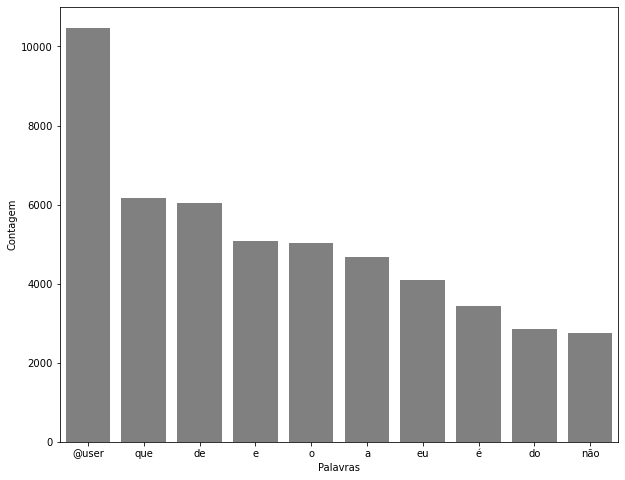

In [52]:
#Esta função servirá para visualizar aas palavras mais repetidas
def pareto(texto, coluna_texto, quantidade):

    todas_palavras = ' '.join([text for text in texto[coluna_texto]])
    token_palavras = token_espaco.tokenize(todas_palavras)
    frequencia = nltk.FreqDist(token_palavras)
    df_frequencia = pd.DataFrame({'Palavras':list(frequencia.keys()), 'Frequencia':list(frequencia.values())})


    plt.figure(figsize = (10, 8))

    ax = sns.barplot(data = df_frequencia.nlargest(columns = 'Frequencia', n = quantidade), x = 'Palavras', y = 'Frequencia', color = 'gray')
    ax.set(ylabel = 'Contagem')

    plt.show()
pareto(dados, 'text', 10)

In [56]:
palavras_irrelevantes = nltk.corpus.stopwords.words("portuguese")

In [57]:
from string import punctuation

pontuacao = list(punctuation)
pontuacao_stopwords = pontuacao + palavras_irrelevantes

In [58]:
token_pontuacao = nltk.tokenize.WordPunctTokenizer()
frase = "Olá,mundo!!!"
token_frase = token_pontuacao.tokenize(frase)

print(token_frase)
     

['Olá', ',', 'mundo', '!!!']


In [100]:
'estar' in palavras_irrelevantes

True

### Primeiro Tratamento: Retirar letras e palavras indesejadas

In [59]:
# Adicionar palavras à lista de stopwords
retirar = ['@','user', 'rt', 'https','://', 't', 'q', 'ta','to']
for i in retirar:
    pontuacao_stopwords.append(i)

In [102]:
# Fazendo primeiro tratamento, também retirando pontuações
token_pontuacao = nltk.tokenize.WordPunctTokenizer()
frase_processada = list()
#Tratamento 1: Retirar pontuações e stopwords básicas.
for opiniao in dados['text']:
    #Tratamento 1 tokenização de espaço
    nova_frase = list()
    palavras_texto = token_pontuacao.tokenize(opiniao)

    for palavra in palavras_texto:
        if palavra not in pontuacao_stopwords:
            nova_frase.append(palavra)

    frase_processada.append(' '.join(nova_frase))

dados['tratamento_1'] = frase_processada

In [103]:
dados.head(2)

,text,label,tratamento_1,tratamento_2,tratamento_3
0,"rt @user olha quem chegouuuuu, nossos queridin...",0,olha chegouuuuu queridinhos !!! vem direção 🤩 ...,olha chegouuuuu queridinhos !!! vem direcao fe...,olh chegouuuuu querid !!! vem direca fem 10 15...
1,veio umas teorias muito loucas na minha cabeça...,1,veio umas teorias loucas cabeça agora pqp assu...,veio umas teorias loucas cabeca agora pqp to a...,vei uma teor louc cabec agor pqp to assust


In [104]:
frase = dados.text[0]
token_frase = token_pontuacao.tokenize(frase)

print(token_frase)

['rt', '@', 'user', 'olha', 'quem', 'chegouuuuu', ',', 'nossos', 'queridinhos', '!!!', 'vem', 'na', 'minha', 'direção', '🤩', 'fem', '👧:', '10', '/', '15', 'masc', '👦:', '25', '/', '40', '#', 'qqmt', 'https', '://', 't', '.', 'co', '/', 'jivoqeuq', '…']


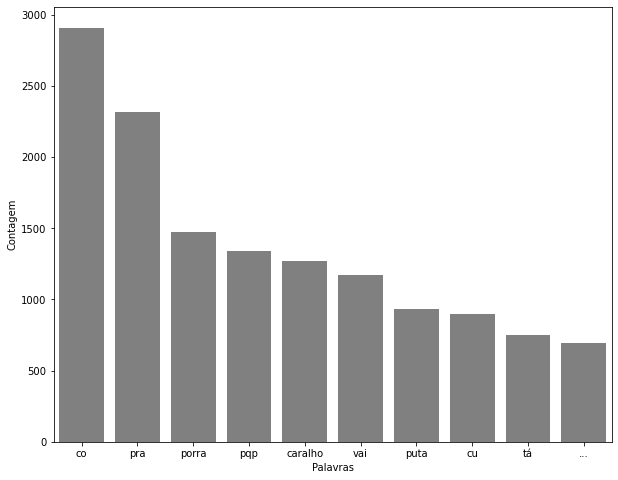

In [105]:
pareto(dados, 'tratamento_1', 10)

### Segundo Tratamento: Retirar acentos

In [106]:
import unidecode

In [107]:
sem_acentos = [unidecode.unidecode(texto) for texto in dados['tratamento_1']]
stopwords_acento = [unidecode.unidecode(texto) for texto in pontuacao_stopwords]

In [108]:
dados['tratamento_2'] = sem_acentos
frase_processada = list()

for opiniao in dados['tratamento_2']:
    opiniao = opiniao.lower()
    nova_frase = list()
    palavras_texto = token_pontuacao.tokenize(opiniao)

    for palavra in palavras_texto:
        if palavra not in stopwords_acento:
            nova_frase.append(palavra)

    frase_processada.append(' '.join(nova_frase))

dados['tratamento_2'] = frase_processada
dados.head()

,text,label,tratamento_1,tratamento_2,tratamento_3
0,"rt @user olha quem chegouuuuu, nossos queridin...",0,olha chegouuuuu queridinhos !!! vem direção 🤩 ...,olha chegouuuuu queridinhos !!! vem direcao fe...,olh chegouuuuu querid !!! vem direca fem 10 15...
1,veio umas teorias muito loucas na minha cabeça...,1,veio umas teorias loucas cabeça agora pqp assu...,veio umas teorias loucas cabeca agora pqp assu...,vei uma teor louc cabec agor pqp to assust
2,@user @user 😂😂😂😂mais nao tinha falado ontem qu...,0,😂😂😂😂 nao falado ontem ia patrocinado nada pude...,falado ontem ia patrocinado nada pudesse viola...,fal ont ia patrocin nad pud viol moral famil b...
3,rt @user quer ser filha da puta logo comigo qu...,1,quer filha puta logo comigo 50x pior kkkkkkkkk...,quer filha puta logo comigo 50x pior kkkkkkkkk...,qu filh put log comig 50x pi kkkkkkkkkkkkkk fi...
4,vai besta 😂😂😂😂 casquei com a ultima foto,1,vai besta 😂😂😂😂 casquei ultima foto,vai besta casquei ultima foto,vai best casq ult fot


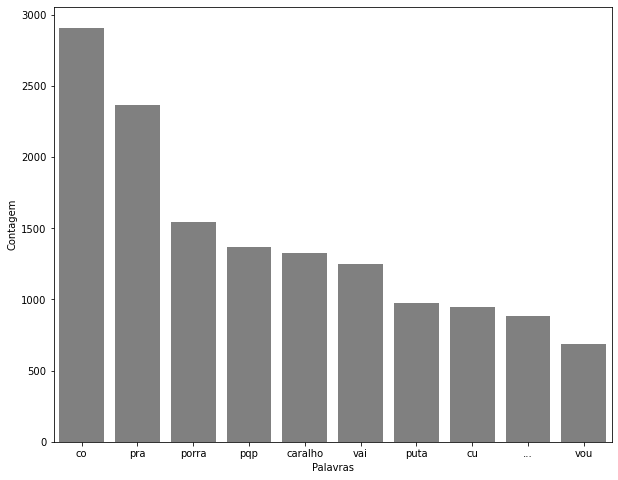

In [109]:
pareto(dados, 'tratamento_2', 10)

### Terceiro Tratamento: Stemmer

In [110]:
stemmer = nltk.RSLPStemmer()

In [111]:
frase_processada = list()

for opiniao in dados['tratamento_2']:
    nova_frase = list()
    palavras_texto = token_pontuacao.tokenize(opiniao)

    for palavra in palavras_texto:
        if palavra not in stopwords_acento:
            nova_frase.append(stemmer.stem(palavra))

    frase_processada.append(' '.join(nova_frase))

dados['tratamento_3'] = frase_processada
dados.head()

,text,label,tratamento_1,tratamento_2,tratamento_3
0,"rt @user olha quem chegouuuuu, nossos queridin...",0,olha chegouuuuu queridinhos !!! vem direção 🤩 ...,olha chegouuuuu queridinhos !!! vem direcao fe...,olh chegouuuuu querid !!! vem direca fem 10 15...
1,veio umas teorias muito loucas na minha cabeça...,1,veio umas teorias loucas cabeça agora pqp assu...,veio umas teorias loucas cabeca agora pqp assu...,vei uma teor louc cabec agor pqp assust
2,@user @user 😂😂😂😂mais nao tinha falado ontem qu...,0,😂😂😂😂 nao falado ontem ia patrocinado nada pude...,falado ontem ia patrocinado nada pudesse viola...,fal ont ia patrocin nad pud viol moral famil b...
3,rt @user quer ser filha da puta logo comigo qu...,1,quer filha puta logo comigo 50x pior kkkkkkkkk...,quer filha puta logo comigo 50x pior kkkkkkkkk...,qu filh put log comig 50x pi kkkkkkkkkkkkkk fi...
4,vai besta 😂😂😂😂 casquei com a ultima foto,1,vai besta 😂😂😂😂 casquei ultima foto,vai besta casquei ultima foto,vai best casq ult fot


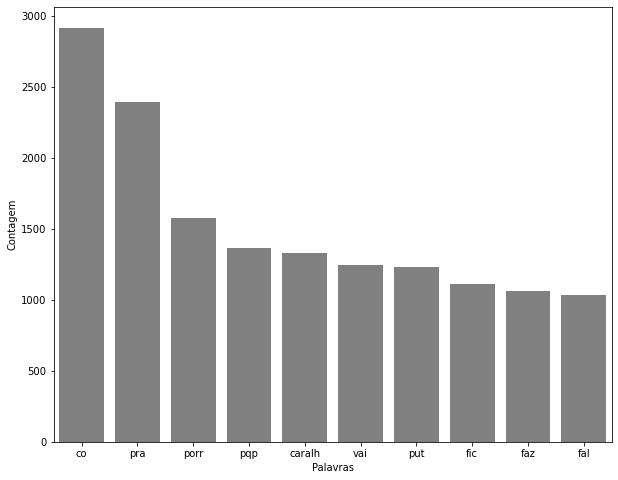

In [112]:
pareto(dados, 'tratamento_3', 10)

### Quarto tratamento: Retirar dados numéricos

In [62]:
frase_processada = list()

for opiniao in dados['tratamento_3']:
    nova_frase = list()
    palavras_texto = token_pontuacao.tokenize(opiniao)

    for palavra in palavras_texto:
        if palavra.isalpha():
            nova_frase.append(palavra)

    frase_processada.append(' '.join(nova_frase))

dados['tratamento_4'] = frase_processada
dados.head()

,text,label,tratamento_1,tratamento_2,tratamento_3,tratamento_4
0,"rt @user olha quem chegouuuuu, nossos queridin...",0,olha chegouuuuu queridinhos !!! vem direção 🤩 ...,olha chegouuuuu queridinhos !!! vem direcao fe...,olh chegouuuuu querid !!! vem direca fem 10 15...,olh chegouuuuu querid vem direca fem masc qqmt...
1,veio umas teorias muito loucas na minha cabeça...,1,veio umas teorias loucas cabeça agora pqp assu...,veio umas teorias loucas cabeca agora pqp assu...,vei uma teor louc cabec agor pqp assust,vei uma teor louc cabec agor pqp assust
2,@user @user 😂😂😂😂mais nao tinha falado ontem qu...,0,😂😂😂😂 nao falado ontem ia patrocinado nada pude...,falado ontem ia patrocinado nada pudesse viola...,fal ont ia patrocin nad pud viol moral famil b...,fal ont ia patrocin nad pud viol moral famil b...
3,rt @user quer ser filha da puta logo comigo qu...,1,quer filha puta logo comigo 50x pior kkkkkkkkk...,quer filha puta logo comigo 50x pior kkkkkkkkk...,qu filh put log comig 50x pi kkkkkkkkkkkkkk fi...,qu filh put log comig pi kkkkkkkkkkkkkk fic sapat
4,vai besta 😂😂😂😂 casquei com a ultima foto,1,vai besta 😂😂😂😂 casquei ultima foto,vai besta casquei ultima foto,vai best casq ult fot,vai best casq ult fot


### TF-IDF e Ngrams

In [3]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [117]:
tfidf = TfidfVectorizer(lowercase=False, ngram_range = (1, 2))
vetor_tfidf = tfidf.fit_transform(dados['tratamento_3'])

### Agrupando os tratamentos

* O tratamento 5 é aplicação de todos os tratamentos, sem realizar a Stemmização

In [4]:
from sklearn.feature_extraction.text import CountVectorizer
import nltk
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression, RidgeClassifier
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
nltk.download("all") 

from string import punctuation

pontuacao = list(punctuation)
import unidecode


def tratamentos(dataset):

    palavras_irrelevantes = nltk.corpus.stopwords.words("portuguese")
    pontuacao = list(punctuation)
    pontuacao_stopwords = pontuacao + palavras_irrelevantes
    retirar = ['@','user', 'rt', 'https','://', 't', 'q', 'ta','to']
    for i in retirar:
        pontuacao_stopwords.append(i)

    token_pontuacao = nltk.tokenize.WordPunctTokenizer()
    frase_processada = list()
    #Tratamento 1: Retirar pontuações e stopwords básicas.
    for opiniao in dataset['text']:
        #Tratamento 1 tokenização de espaço
        nova_frase = list()
        palavras_texto = token_pontuacao.tokenize(opiniao)

        for palavra in palavras_texto:
            if palavra not in pontuacao_stopwords:
                nova_frase.append(palavra)

        frase_processada.append(' '.join(nova_frase))

    dataset['tratamento_1'] = frase_processada
    #print(dataset)

    sem_acentos = [unidecode.unidecode(texto) for texto in dataset['tratamento_1']]
    
    stopwords_acento = [unidecode.unidecode(texto) for texto in pontuacao_stopwords]
    dataset['tratamento_2'] = sem_acentos
    frase_processada = list()

    for opiniao in dataset['tratamento_2']:
        opiniao = opiniao.lower()
        nova_frase = list()
        palavras_texto = token_pontuacao.tokenize(opiniao)

        for palavra in palavras_texto:
            if palavra not in stopwords_acento:
                nova_frase.append(palavra)

        frase_processada.append(' '.join(nova_frase))

    dataset['tratamento_2'] = frase_processada


    stemmer = nltk.RSLPStemmer()
    frase_processada = list()

    for opiniao in dataset['tratamento_2']:
        nova_frase = list()
        palavras_texto = token_pontuacao.tokenize(opiniao)

        for palavra in palavras_texto:
            if palavra not in stopwords_acento:
                nova_frase.append(stemmer.stem(palavra))

        frase_processada.append(' '.join(nova_frase))

    dataset['tratamento_3'] = frase_processada
    
    frase_processada = list()

    for opiniao in dataset['tratamento_3']:
        nova_frase = list()
        palavras_texto = token_pontuacao.tokenize(opiniao)

        for palavra in palavras_texto:
            if palavra.isalpha():
                nova_frase.append(palavra)

        frase_processada.append(' '.join(nova_frase))

    dataset['tratamento_4'] = frase_processada
    
    frase_processada = list()
    for opiniao in dataset['tratamento_2']:
        nova_frase = list()
        palavras_texto = token_pontuacao.tokenize(opiniao)

        for palavra in palavras_texto:
            if palavra.isalpha():
                nova_frase.append(palavra)

        frase_processada.append(' '.join(nova_frase))

    dataset['tratamento_5'] = frase_processada
    
    return dataset


print('oi')   
treino = tratamentos(dados)

teste = pd.read_csv('test (4).csv')
teste_trat = tratamentos(teste)

[nltk_data] Downloading collection 'all'
[nltk_data]    | 
[nltk_data]    | Downloading package abc to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package abc is already up-to-date!
[nltk_data]    | Downloading package alpino to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package alpino is already up-to-date!
[nltk_data]    | Downloading package averaged_perceptron_tagger to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package averaged_perceptron_tagger is already up-
[nltk_data]    |       to-date!
[nltk_data]    | Downloading package averaged_perceptron_tagger_ru to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    |   Package averaged_perceptron_tagger_ru is already
[nltk_data]    |       up-to-date!
[nltk_data]    | Downloading package basque_grammars to
[nltk_data]    |     C:\Users\kauea\AppData\Roaming\nltk_data...
[nltk_data]    | 

oi


In [6]:
import imblearn

In [7]:
undersample = imblearn.under_sampling.RandomUnderSampler(sampling_strategy=0.8)
tfidf_ = TfidfVectorizer(lowercase=False, ngram_range = (1, 2), max_features = 2100)
vetor_tfidf_ = tfidf_.fit_transform(treino['tratamento_5'])

x_treino_, x_teste_, y_treino_, y_teste_ = train_test_split(vetor_tfidf_,
                                                                  treino['label'],
                                                                  random_state = 42, test_size = 0.25)



x_treino_, y_treino_ = undersample.fit_resample(x_treino_, y_treino_)

from lazypredict.Supervised import LazyClassifier



LC = LazyClassifier()
modelos, predicoes = LC.fit(x_treino_.toarray(), x_teste_.toarray(), y_treino_, y_teste_)

print(modelos)

C:\Users\kauea\anaconda3\lib\site-packages\cupy\_environment.py:213: UserWarning: CUDA path could not be detected. Set CUDA_PATH environment variable if CuPy fails to load.
  warnings.warn(
 97%|███████████████████████████████████████████████████████████████████████████████▏  | 28/29 [26:40<00:48, 48.75s/it]

[LightGBM] [Info] Number of positive: 5522, number of negative: 6902
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016603 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 22122
[LightGBM] [Info] Number of data points in the train set: 12424, number of used features: 849
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.444462 -> initscore=-0.223071
[LightGBM] [Info] Start training from score -0.223071


100%|██████████████████████████████████████████████████████████████████████████████████| 29/29 [26:43<00:00, 55.30s/it]

                               Accuracy  Balanced Accuracy  ROC AUC  F1 Score  \
Model                                                                           
LGBMClassifier                     0.76               0.75     0.75      0.76   
ExtraTreesClassifier               0.75               0.75     0.75      0.75   
RandomForestClassifier             0.75               0.75     0.75      0.75   
XGBClassifier                      0.75               0.74     0.74      0.75   
BaggingClassifier                  0.73               0.73     0.73      0.73   
BernoulliNB                        0.73               0.72     0.72      0.72   
RidgeClassifierCV                  0.72               0.72     0.72      0.72   
RidgeClassifier                    0.72               0.72     0.72      0.72   
LinearDiscriminantAnalysis         0.72               0.72     0.72      0.72   
AdaBoostClassifier                 0.73               0.72     0.72      0.73   
DecisionTreeClassifier      

In [85]:
treino.head()

,text,label,tratamento_1,tratamento_2,tratamento_3,tratamento_4,tratamento_5
0,"rt @user olha quem chegouuuuu, nossos queridin...",0,olha chegouuuuu queridinhos !!! vem direção 🤩 ...,olha chegouuuuu queridinhos !!! vem direcao fe...,olh chegouuuuu querid !!! vem direca fem 10 15...,olh chegouuuuu querid vem direca fem masc qqmt...,olha chegouuuuu queridinhos vem direcao fem ma...
1,veio umas teorias muito loucas na minha cabeça...,1,veio umas teorias loucas cabeça agora pqp assu...,veio umas teorias loucas cabeca agora pqp assu...,vei uma teor louc cabec agor pqp assust,vei uma teor louc cabec agor pqp assust,veio umas teorias loucas cabeca agora pqp assu...
2,@user @user 😂😂😂😂mais nao tinha falado ontem qu...,0,😂😂😂😂 nao falado ontem ia patrocinado nada pude...,falado ontem ia patrocinado nada pudesse viola...,fal ont ia patrocin nad pud viol moral famil b...,fal ont ia patrocin nad pud viol moral famil b...,falado ontem ia patrocinado nada pudesse viola...
3,rt @user quer ser filha da puta logo comigo qu...,1,quer filha puta logo comigo 50x pior kkkkkkkkk...,quer filha puta logo comigo 50x pior kkkkkkkkk...,qu filh put log comig 50x pi kkkkkkkkkkkkkk fi...,qu filh put log comig pi kkkkkkkkkkkkkk fic sapat,quer filha puta logo comigo pior kkkkkkkkkkkkk...
4,vai besta 😂😂😂😂 casquei com a ultima foto,1,vai besta 😂😂😂😂 casquei ultima foto,vai besta casquei ultima foto,vai best casq ult fot,vai best casq ult fot,vai besta casquei ultima foto


In [86]:
teste_trat.head()

,id,text,tratamento_1,tratamento_2,tratamento_3,tratamento_4,tratamento_5
0,0,@user nossa mano te odeio na moral kkkkkkkkkkk...,mano odeio moral kkkkkkkkkkkkkkkkkkk,mano odeio moral kkkkkkkkkkkkkkkkkkk,man odei moral kkkkkkkkkkkkkkkkkkk,man odei moral kkkkkkkkkkkkkkkkkkk,mano odeio moral kkkkkkkkkkkkkkkkkkk
1,1,@user @user a edição ficou muito boa! kkkkkkkk...,"edição ficou boa kkkkkkkkkkk faltou luka time "".","edicao ficou boa kkkkkkkkkkk faltou luka time "".","edica fic boa kkkkkkkkkkk falt luk tim "".",edica fic boa kkkkkkkkkkk falt luk tim,edicao ficou boa kkkkkkkkkkk faltou luka time
2,2,"@user largada vá, visto que a vaca anda à solta 😂",largada vá visto vaca anda solta 😂,largada va visto vaca anda solta,larg va vist vac and solt,larg va vist vac and solt,largada va visto vaca anda solta
3,3,"poxa, eu queria ganhar um boné. alguém me da u...",poxa queria ganhar boné alguém boné :(((,poxa queria ganhar bone alguem bone :(((,pox quer ganh bon algu bon :(((,pox quer ganh bon algu bon,poxa queria ganhar bone alguem bone
4,4,"@user amiga, tudo bem, não precisa se desculpa...",amiga tudo bem precisa desculpar escroto enten...,amiga tudo bem precisa desculpar escroto enten...,amig tud bem precis desculp escrot entend qu,amig tud bem precis desculp escrot entend qu,amiga tudo bem precisa desculpar escroto enten...


### Treinando Modelo Logistic com Bag of Words
* O Bag of Words servirá como Baseline do modelo

In [10]:
from sklearn.linear_model import LogisticRegression, RidgeClassifier
from sklearn.model_selection import train_test_split, cross_validate, KFold
from sklearn.feature_extraction.text import TfidfVectorizer

In [89]:

def classificar_texto(texto, coluna_texto, coluna_classificacao):
    vetorizar = CountVectorizer(lowercase = False, max_features = 50)
    bag_of_words  = vetorizar.fit_transform( texto[coluna_texto] )

    x_treino, x_teste, y_treino, y_teste = train_test_split(bag_of_words,
                                                          texto[coluna_classificacao],
                                                          random_state = 42)

    regressao_logistica = LogisticRegression()
    regressao_logistica.fit(x_treino, y_treino)
    acuracy = regressao_logistica.score(x_teste, y_teste)
    print(round(acuracy, 3))
classificar_texto(treino, 'text', 'label')
classificar_texto(treino, 'tratamento_1', 'label')
classificar_texto(treino, 'tratamento_2', 'label')
classificar_texto(treino, 'tratamento_3', 'label')
classificar_texto(treino, 'tratamento_4', 'label')
classificar_texto(treino, 'tratamento_5', 'label')

0.672
0.673
0.677
0.693
0.693
0.677


In [98]:
teste.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4200 entries, 0 to 4199
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   id            4200 non-null   int64 
 1   text          4200 non-null   object
 2   tratamento_1  4200 non-null   object
 3   tratamento_2  4200 non-null   object
 4   tratamento_3  4200 non-null   object
 5   tratamento_4  4200 non-null   object
 6   tratamento_5  4200 non-null   object
dtypes: int64(1), object(6)
memory usage: 229.8+ KB


In [104]:
def tf_id(coluna):
    tfidf_ = TfidfVectorizer(lowercase=False, ngram_range = (1, 2), max_features = 2100)
    vetor_tfidf_ = tfidf_.fit_transform(treino[coluna])

    x_treino_, x_teste_, y_treino_, y_teste_ = train_test_split(vetor_tfidf_,
                                                                  dados['label'],
                                                                  random_state = 42, test_size = 0.25)

    LR_ = LogisticRegression()

    LR_.fit(x_treino_, y_treino_)
    acuracia_tfidf_ = LR_.score(x_teste_, y_teste_)

    print(acuracia_tfidf_)
tf_id('text')
tf_id('tratamento_1')
tf_id('tratamento_2')
tf_id('tratamento_3')
tf_id('tratamento_4')
tf_id('tratamento_5')

0.7466666666666667
0.7476190476190476
0.7521428571428571
0.7495238095238095
0.7485714285714286
0.7523809523809524


In [4]:
from sklearn.naive_bayes import GaussianNB, MultinomialNB, ComplementNB, BernoulliNB

def tf_id_modelo(coluna, modelo):
    tfidf_ = TfidfVectorizer(lowercase=False, ngram_range = (1, 2), max_features = 2100)
    
    vetor_tfidf_ = tfidf_.fit_transform(treino[coluna])

    x_treino_, x_teste_, y_treino_, y_teste_ = train_test_split(vetor_tfidf_,
                                                                  treino['label'],
                                                                  random_state = 42, test_size = 0.25)
    
    KF = KFold(n_splits = 5, shuffle = True, random_state=42)
    cv_resultados = cross_validate(modelo(), x_treino_.toarray(), y_treino_, cv = KF )
    print('Média Treino: ',cv_resultados['test_score'].mean())
    print('Desvio Treino: ',cv_resultados['test_score'].std())

    molelo_treinado = modelo()
    molelo_treinado.fit(x_treino_.toarray(), y_treino_)
    acuracia_tfidf_ = molelo_treinado.score(x_teste_.toarray(), y_teste_)

    print('Valor Final: ',acuracia_tfidf_)

In [106]:


for i in [LogisticRegression, GaussianNB, MultinomialNB, ComplementNB, BernoulliNB, RidgeClassifier ]:
    print(str(i), '\n')
    for ii in ['tratamento_2', 'tratamento_3', 'tratamento_5']:
        print(ii)
        tf_id_modelo(ii, i)
    print('\n')


<class 'sklearn.linear_model._logistic.LogisticRegression'> 

tratamento_2
Média Treino:  0.7296031746031747
Desvio Treino:  0.005309755137675494
Valor Final:  0.7521428571428571
tratamento_3
Média Treino:  0.7310317460317461
Desvio Treino:  0.005500864587670971
Valor Final:  0.7495238095238095
tratamento_5
Média Treino:  0.730952380952381
Desvio Treino:  0.005112737589970312
Valor Final:  0.7523809523809524


<class 'sklearn.naive_bayes.GaussianNB'> 

tratamento_2
Média Treino:  0.5776984126984127
Desvio Treino:  0.0070514432638861075
Valor Final:  0.585
tratamento_3
Média Treino:  0.569047619047619
Desvio Treino:  0.004566079321791262
Valor Final:  0.5764285714285714
tratamento_5
Média Treino:  0.5764285714285714
Desvio Treino:  0.010799484884554959
Valor Final:  0.5842857142857143


<class 'sklearn.naive_bayes.MultinomialNB'> 

tratamento_2
Média Treino:  0.707936507936508
Desvio Treino:  0.007009334020895123
Valor Final:  0.7214285714285714
tratamento_3
Média Treino:  0.71285714285

#### Usar de baseline 0.69

In [10]:
from sklearn.ensemble import RandomForestClassifier, HistGradientBoostingClassifier
from sklearn.ensemble import AdaBoostClassifier, BaggingClassifier, GradientBoostingClassifier

for i in [RandomForestClassifier, HistGradientBoostingClassifier]:
    print(str(i), '\n')
    for ii in ['tratamento_2', 'tratamento_3', 'tratamento_5']:
        print(ii)
        tf_id_modelo(ii, i)
    print('\n')

<class 'sklearn.ensemble._forest.RandomForestClassifier'> 

tratamento_2
Média Treino:  0.7361904761904763
Desvio Treino:  0.0079697715623068
Valor Final:  0.7483333333333333
tratamento_3
Média Treino:  0.7392063492063492
Desvio Treino:  0.0068106152231508
Valor Final:  0.7490476190476191
tratamento_5
Média Treino:  0.7357936507936509
Desvio Treino:  0.006934346399619947
Valor Final:  0.75


<class 'sklearn.ensemble._hist_gradient_boosting.gradient_boosting.HistGradientBoostingClassifier'> 

tratamento_2
Média Treino:  0.7372222222222222
Desvio Treino:  0.008792705238258796
Valor Final:  0.7595238095238095
tratamento_3
Média Treino:  0.7441269841269842
Desvio Treino:  0.008892431266939239
Valor Final:  0.745
tratamento_5
Média Treino:  0.7325396825396826
Desvio Treino:  0.0065829972550246925
Valor Final:  0.7597619047619047




In [5]:
tfidf_ = TfidfVectorizer(lowercase=False, ngram_range = (1, 2), max_features = 2100)
    
vetor_tfidf_ = tfidf_.fit_transform(treino["tratamento_5"])

x_treino, x_teste, y_treino, y_teste= train_test_split(vetor_tfidf_,
                                                                  treino['label'],
                                                                  random_state = 42, test_size = 0.25)

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC

for i in [KNeighborsClassifier, SVC]:
    print(str(i), '\n')
    for ii in ['tratamento_2', 'tratamento_5']:
        print(ii)
        tf_id_modelo(ii, i)
    print('\n')

<class 'sklearn.neighbors._classification.KNeighborsClassifier'> 

tratamento_2


C:\Users\kauea\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\kauea\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

Média Treino:  0.6221428571428571
Desvio Treino:  0.006236095644623214


C:\Users\kauea\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


Valor Final:  0.6252380952380953
tratamento_5


C:\Users\kauea\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\kauea\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdim

Média Treino:  0.6282539682539683
Desvio Treino:  0.006077520545738596


C:\Users\kauea\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


Valor Final:  0.6226190476190476


<class 'sklearn.svm._classes.SVC'> 

tratamento_2
Média Treino:  0.7341269841269842
Desvio Treino:  0.006886950206322763


In [10]:
from sklearn.ensemble import HistGradientBoostingClassifier
HGB = HistGradientBoostingClassifier()
HGB.fit(x_treino.toarray(), y_treino)
acuracia_tfidf = HGB.score(x_teste.toarray(), y_teste)

print( acuracia_tfidf)

0.7521428571428571


## Criando modelo com Deep Learning

In [25]:
x_treino.shape

(12600, 1000)

In [28]:
!pip install tensorflow

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
streamlit 1.16.0 requires protobuf<4,>=3.12, but you have protobuf 4.25.3 which is incompatible.
google-cloud-storage 1.31.0 requires google-auth<2.0dev,>=1.11.0, but you have google-auth 2.28.1 which is incompatible.
google-cloud-core 1.7.1 requires google-auth<2.0dev,>=1.24.0, but you have google-auth 2.28.1 which is incompatible.
google-api-core 1.25.1 requires google-auth<2.0dev,>=1.21.1, but you have google-auth 2.28.1 which is incompatible.


  Attempting uninstall: google-auth
    Found existing installation: google-auth 1.33.0
    Uninstalling google-auth-1.33.0:
      Successfully uninstalled google-auth-1.33.0
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.20.1
    Uninstalling protobuf-3.20.1:
      Successfully uninstalled protobuf-3.20.1
  Attempting uninstall: grpcio
    Found existing installation: grpcio 1.42.0
    Uninstalling grpcio-1.42.0:
      Successfully uninstalled grpcio-1.42.0


In [18]:
import tensorflow
from tensorflow import keras
from keras.regularizers import l2


In [23]:
tfidf_ = TfidfVectorizer(lowercase=False, ngram_range = (1, 2), max_features = 1000)
    
vetor_tfidf_ = tfidf_.fit_transform(dados['tratamento_3'])

x_treino, x_teste, y_treino, y_teste = train_test_split(vetor_tfidf_,
                                                                  dados['label'],
                                                                  random_state = 42, test_size = 0.25)
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
scaler.fit(x_treino.toarray())
x_treino = scaler.transform(x_treino.toarray())

x_teste = scaler.transform(x_teste.toarray())

#### Fazer MinMaxScaler dos dados de teste também, usando apenas transform

In [20]:
tfidf_ = TfidfVectorizer(lowercase=False, ngram_range = (1, 2), max_features = 1000)
    
vetor_tfidf_ = tfidf_.fit_transform(dados['tratamento_5'])

x_treino, x_teste, y_treino, y_teste = train_test_split(vetor_tfidf_,
                                                                  dados['label'],
                                                                  random_state = 42, test_size = 0.25)

x_treino = x_treino.toarray()
x_teste = x_teste.toarray()

In [21]:
for i in [2**x for x in range(1, 8)]:
    modelo_keras = keras.Sequential([
        keras.layers.Dense(i, activation = tensorflow.nn.relu),
        keras.layers.Dense(2, activation = tensorflow.nn.relu),
        keras.layers.Dense(units = 1, activation = tensorflow.nn.sigmoid)
    ])


    optimizer = keras.optimizers.Adam(learning_rate=0.001) 
    modelo_keras.compile(optimizer = optimizer,
                  loss = 'binary_crossentropy',
                        metrics=['accuracy'])
    modelo_keras.fit(x_treino, y_treino, epochs=6, validation_data=(x_teste, y_teste))

    results = modelo_keras.evaluate(x_teste,  y_teste, verbose=2)
    print(f'quantidade: {i}')
    print(results)

Epoch 1/6
394/394 [==============================] - 1s 2ms/step - loss: 0.6798 - accuracy: 0.6277 - val_loss: 0.6522 - val_accuracy: 0.7150
Epoch 2/6
394/394 [==============================] - 1s 1ms/step - loss: 0.6003 - accuracy: 0.7237 - val_loss: 0.5601 - val_accuracy: 0.7393
Epoch 3/6
394/394 [==============================] - 1s 1ms/step - loss: 0.5303 - accuracy: 0.7471 - val_loss: 0.5305 - val_accuracy: 0.7429
Epoch 4/6
394/394 [==============================] - 1s 1ms/step - loss: 0.5026 - accuracy: 0.7581 - val_loss: 0.5235 - val_accuracy: 0.7474
Epoch 5/6
394/394 [==============================] - 1s 1ms/step - loss: 0.4899 - accuracy: 0.7645 - val_loss: 0.5219 - val_accuracy: 0.7493
Epoch 6/6
394/394 [==============================] - 1s 1ms/step - loss: 0.4822 - accuracy: 0.7694 - val_loss: 0.5207 - val_accuracy: 0.7507
132/132 - 0s - loss: 0.5207 - accuracy: 0.7507 - 110ms/epoch - 830us/step
quantidade: 2
[0.520696759223938, 0.7507143020629883]
Epoch 1/6
394/394 [=======

In [22]:
modelo_keras = keras.Sequential([
        keras.layers.Dense(16, activation = tensorflow.nn.relu),
        keras.layers.Dense(2, activation = tensorflow.nn.relu),
        keras.layers.Dense(units = 1, activation = tensorflow.nn.sigmoid)
    ])


optimizer = keras.optimizers.Adam(learning_rate=0.001) 
modelo_keras.compile(optimizer = optimizer,
              loss = 'binary_crossentropy',
                    metrics=['accuracy'])
modelo_keras.fit(x_treino, y_treino, epochs=6, validation_data=(x_teste, y_teste))

results = modelo_keras.evaluate(x_teste,  y_teste, verbose=2)
print(f'quantidade: {i}')
print(results)

Epoch 1/6
394/394 [==============================] - 1s 2ms/step - loss: 0.6557 - accuracy: 0.6331 - val_loss: 0.5827 - val_accuracy: 0.7210
Epoch 2/6
394/394 [==============================] - 1s 2ms/step - loss: 0.5408 - accuracy: 0.7390 - val_loss: 0.5292 - val_accuracy: 0.7436
Epoch 3/6
394/394 [==============================] - 1s 2ms/step - loss: 0.5024 - accuracy: 0.7517 - val_loss: 0.5243 - val_accuracy: 0.7452
Epoch 4/6
394/394 [==============================] - 1s 2ms/step - loss: 0.4868 - accuracy: 0.7646 - val_loss: 0.5214 - val_accuracy: 0.7469
Epoch 5/6
394/394 [==============================] - 1s 2ms/step - loss: 0.4758 - accuracy: 0.7703 - val_loss: 0.5205 - val_accuracy: 0.7471
Epoch 6/6
394/394 [==============================] - 1s 2ms/step - loss: 0.4675 - accuracy: 0.7752 - val_loss: 0.5222 - val_accuracy: 0.7512
132/132 - 0s - loss: 0.5222 - accuracy: 0.7512 - 179ms/epoch - 1ms/step
quantidade: 128
[0.5221917033195496, 0.7511904835700989]


In [57]:
results = modelo_keras.evaluate(x_teste,  y_teste, verbose=2)

print(results)

132/132 - 0s - loss: 0.5231 - accuracy: 0.7538 - 142ms/epoch - 1ms/step
[0.5231285095214844, 0.7538095116615295]


## Alterando Threashold

In [30]:
vetor_tfidf_ = tfidf_.fit_transform(treino["tratamento_5"])

x_treino, x_teste, y_treino, y_teste= train_test_split(vetor_tfidf_,
                                                                  treino['label'],
                                                                  random_state = 42, test_size = 0.25)
proba = HGB.predict_proba(x_teste.toarray())

In [40]:
treino['label'].values

array([0, 1, 0, ..., 1, 0, 0], dtype=int64)

In [42]:

df_proba = pd.DataFrame(proba)
df_proba

,0,1
0,0.367643,0.632357
1,0.595230,0.404770
2,0.753117,0.246883
3,0.823068,0.176932
4,0.424078,0.575922
...,...,...
4195,0.387804,0.612196
4196,0.521349,0.478651
4197,0.530684,0.469316
4198,0.707111,0.292889


In [13]:
from sklearn.metrics import accuracy_score



In [15]:

proba = HGB.predict_proba(x_teste.toarray())
df_proba = pd.DataFrame(proba)
df_proba
for i in [x/10 for x in range(0, 10)]:
    y_predito = df_proba.applymap(lambda x: 1 if x>i else 0)
    y_val_pred = y_predito[1].values
    print('Valores: ', y_val_pred)
    acuracia = accuracy_score(y_teste, y_val_pred)

    print(str(i), acuracia, '\n')
    

Valores:  [1 1 1 ... 1 1 1]
0.0 0.4411904761904762 

Valores:  [1 1 1 ... 1 1 0]
0.1 0.48547619047619045 

Valores:  [1 1 1 ... 1 1 0]
0.2 0.6359523809523809 

Valores:  [1 1 0 ... 1 1 0]
0.3 0.7373809523809524 

Valores:  [1 0 0 ... 1 0 0]
0.4 0.7566666666666667 

Valores:  [1 0 0 ... 0 0 0]
0.5 0.7566666666666667 

Valores:  [1 0 0 ... 0 0 0]
0.6 0.7314285714285714 

Valores:  [0 0 0 ... 0 0 0]
0.7 0.69 

Valores:  [0 0 0 ... 0 0 0]
0.8 0.6511904761904762 

Valores:  [0 0 0 ... 0 0 0]
0.9 0.6190476190476191 



In [16]:
import numpy as np
for i in np.linspace(0.44, 0.5, 12):
    y_predito = df_proba.applymap(lambda x: 1 if x>i else 0)
    y_val_pred = y_predito[1].values
    print('Valores: ', y_val_pred)
    acuracia = accuracy_score(y_teste, y_val_pred)

    print(str(i), acuracia, '\n')

Valores:  [1 0 0 ... 1 0 0]
0.44 0.758095238095238 

Valores:  [1 0 0 ... 1 0 0]
0.44545454545454544 0.7585714285714286 

Valores:  [1 0 0 ... 1 0 0]
0.4509090909090909 0.7576190476190476 

Valores:  [1 0 0 ... 1 0 0]
0.45636363636363636 0.758095238095238 

Valores:  [1 0 0 ... 1 0 0]
0.4618181818181818 0.758095238095238 

Valores:  [1 0 0 ... 1 0 0]
0.4672727272727273 0.7578571428571429 

Valores:  [1 0 0 ... 1 0 0]
0.4727272727272727 0.7590476190476191 

Valores:  [1 0 0 ... 1 0 0]
0.47818181818181815 0.758095238095238 

Valores:  [1 0 0 ... 0 0 0]
0.48363636363636364 0.758095238095238 

Valores:  [1 0 0 ... 0 0 0]
0.4890909090909091 0.758095238095238 

Valores:  [1 0 0 ... 0 0 0]
0.49454545454545457 0.7578571428571429 

Valores:  [1 0 0 ... 0 0 0]
0.5 0.7566666666666667 



## Modelo HistGradient -- Tunar Hiperparâmetros

In [8]:
from sklearn.model_selection import GridSearchCV
def tuning(modelo_s, searcher, k_folder, parametros, x_tr, x_te, y_tr, y_te):
    
    modelo = modelo_s(random_state = 42)
    GSC = searcher(modelo, parametros, cv = k_folder)

    GSC.fit(x_tr.toarray(), y_tr)

    print(f'Best Parameters: {GSC.best_params_}')
    print(GSC.best_score_)
    
    best_params = GSC.best_params_
    HGB_best = modelo_s(**best_params)
    HGB_best.fit(x_tr.toarray(), y_tr)

    acuracia = HGB_best.score(x_te.toarray(), y_te)
    print('Valor Final: ',acuracia)
    
    return HGB_best


In [ ]:
from sklearn.model_selection import GridSearchCV

espaco_parametros= {
    "learning_rate": [0.1, 0.05, 0.2, 0.3, 0.03],
    "max_iter": [100, 150, 50],
    "max_depth": [None, 10, 20],
    "min_samples_leaf": [20, 5, 50]
}


tfidf_ = TfidfVectorizer(lowercase=False, ngram_range = (1, 2), max_features = 1000)
    
vetor_tfidf_ = tfidf_.fit_transform(dados['tratamento_5'])

x_treino, x_teste, y_treino, y_teste = train_test_split(vetor_tfidf_,
                                                                  dados['label'],
                                                                  random_state = 42, test_size = 0.25)

KF = KFold(n_splits = 5)

model_best = tuning(HistGradientBoostingClassifier,GridSearchCV, KF, espaco_parametros,
      x_treino, x_teste, y_treino, y_teste)

## Modelo lightGBMClassifier -- Tunar Hiperparâmetros

In [10]:
!pip install lightgbm

In [11]:
from lightgbm import LGBMClassifier

In [18]:
espaco_parametros= {
    "learning_rate": [0.1, 0.03]
}


tfidf_ = TfidfVectorizer(lowercase=False, ngram_range = (1, 2), max_features = 1000)
    
vetor_tfidf_ = tfidf_.fit_transform(dados['tratamento_5'])

x_treino, x_teste, y_treino, y_teste = train_test_split(vetor_tfidf_,
                                                                  dados['label'],
                                                                  random_state = 42, test_size = 0.25)

KF = KFold(n_splits = 5)

model_best = tuning(LGBMClassifier,GridSearchCV, KF, espaco_parametros,
      x_treino, x_teste, y_treino, y_teste)

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011025 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16752
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010629 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16695
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] 

In [73]:
espaco_parametros= {
    "learning_rate": [0.1, 0.05, 0.2, 0.25, 0.3, 0.075],
    "n_estimators": [100, 15, 50, 25, 10],
    "max_depth": [-1, 10, 15, 5, 20, 25],
    "num_leaves": [31, 25, 35, 40],
    "min_split_gain": [0, 0.25, 0.5]
}


tfidf_ = TfidfVectorizer(lowercase=False, ngram_range = (1, 2), max_features = 1000)
    
vetor_tfidf_ = tfidf_.fit_transform(treino['tratamento_5'])

x_treino, x_teste, y_treino, y_teste = train_test_split(vetor_tfidf_,
                                                                  treino['label'],
                                                                  random_state = 42, test_size = 0.2)

KF = KFold(n_splits = 5)

model_best = tuning(LGBMClassifier,GridSearchCV, KF, espaco_parametros,
      x_treino, x_teste, y_treino, y_teste)

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008883 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012475 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011724 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011902 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012966 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012140 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012250 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012931 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[L

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011658 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011919 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012250 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008979 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.148720 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017181 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014632 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016527 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014604 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017296 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014474 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012830 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011843 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012642 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011794 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013280 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013014 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013032 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightG

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013109 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013038 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014729 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[L

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013115 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013363 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012542 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013607 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015588 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013676 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013990 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013413 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013172 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013163 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011959 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015375 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013823 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013475 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014788 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013619 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011155 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightG

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014188 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012631 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012493 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013712 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015355 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012460 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013304 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (nu

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014421 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014497 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth >

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012332 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013366 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012175 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013119 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013484 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012151 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013553 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013266 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011778 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wis

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014041 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012859 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012859 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013651 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012398 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013329 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013009 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014104 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012681 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013140 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number o

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013722 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013953 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightG

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014569 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012963 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011030 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013727 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011491 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014899 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013465 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013001 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014009 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015218 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013147 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013002 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012459 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013787 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010721 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014808 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013484 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013927 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013806 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012423 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015040 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012385 seconds.
You can s

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014105 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013691 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data poin

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013833 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012234 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012655 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012840 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012789 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012261 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013318 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011129 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013974 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013778 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014186 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013938 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013444 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012732 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014919 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013546 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013600 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015107 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013328 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013469 seconds.
You can s

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013485 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011901 seconds.
You can s

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012924 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013444 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012666 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012262 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013834 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012861 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013745 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011884 seconds.
You can s

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014260 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013733 seconds.
You can s

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013859 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014025 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.4

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013894 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014025 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013580 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011823 seconds.
You can s

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012644 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012042 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[L

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013774 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014771 seconds.
You can set `force_row_wise=true` to remove 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013603 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012935 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013007 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015190 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013782 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013866 seconds.
You can s

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013982 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011846 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightG

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013625 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013818 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013696 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012788 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013859 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014229 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013752 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014142 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013937 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013571 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012862 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014294 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008267 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011860 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014006 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013719 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009641 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013683 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013451 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013804 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012314 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013970 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012987 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012457 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013674 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011853 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011846 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012637 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014185 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013271 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014032 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012939 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013392 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014705 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013514 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013385 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013507 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010577 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013955 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012115 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013262 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013026 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014038 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013974 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012509 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013859 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013147 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013688 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013188 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012848 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014155 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016335 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013530 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013534 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012607 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013935 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014112 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013235 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014893 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013728 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015388 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012580 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012784 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013266 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014405 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012371 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014019 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014143 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011417 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013824 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013856 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014030 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012902 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012829 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012142 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014266 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013199 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014290 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013661 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013536 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013394 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013503 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014629 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011806 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013877 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012740 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010698 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014286 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013733 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014174 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013834 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013440 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013480 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015320 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014011 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015446 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012370 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013957 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train se

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013570 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014769 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013758 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014034 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014191 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011165 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013104 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014381 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011123 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014600 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014044 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.020493 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014423 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Inf

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013909 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011452 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014255 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012952 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014490 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start trainin

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013093 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018795 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011123 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014248 seconds.
You can s

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013903 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013826 seconds.
You can s

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012841 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012837 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014854 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012915 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014216 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014475 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014049 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014401 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013285 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy ma

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011246 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012095 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data poin

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011865 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015261 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012395 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011387 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012830 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015719 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number o

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012638 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013763 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013996 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013929 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013878 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013687 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[L

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014166 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (nu

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013458 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013130 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[L

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011788 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014645 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightG

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012437 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014842 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013744 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014027 seconds.
You can s

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013936 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013498 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory i

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015333 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014851 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightG

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013925 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013491 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012909 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013425 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010783 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012190 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013026 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013937 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014419 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014208 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012753 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012920 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013118 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013269 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[L

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014324 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013896 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014235 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013580 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013983 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013773 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013494 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[L

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014618 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015464 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014360 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014400 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[L

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013164 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013216 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[L

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014208 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013618 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014113 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012992 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013748 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014747 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[L

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014189 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013123 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013934 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013505 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014554 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014328 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014313 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013673 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015519 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014637 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[L

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013723 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013601 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013486 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013494 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013843 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013919 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013985 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014103 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013296 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013716 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[L

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014344 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014432 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[L

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013610 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012311 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014998 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is no

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014858 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013207 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013723 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014627 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013224 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012895 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009059 seconds.
You can s

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014432 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013389 seconds.
You can s

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014595 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014236 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data poin

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014052 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010245 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012959 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016968 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012954 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013902 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[L

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013323 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013743 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014218 seconds.
Yo

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014454 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013437 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013479 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013895 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014479 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013943 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014627 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013890 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011882 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014034 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014147 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data poin

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014693 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014628 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015649 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013448 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015052 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015761 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014309 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016417 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012705 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014899 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014173 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013811 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014175 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013544 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 604

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014049 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013675 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory i

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013794 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014128 seconds.
You can s

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013294 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014542 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013906 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014517 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012806 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014083 seconds.
You can s

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013704 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.017082 seconds.
You can s

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014266 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014341 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013637 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013961 seconds.
You can s

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010521 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015451 seconds.
You can s

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014802 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014528 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013821 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012609 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014200 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013878 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014491 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013011 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012487 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013718 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013519 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used f

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014404 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014087 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013006 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014724 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013567 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013691 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013605 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013484 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013338 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011293 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015657 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013312 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014233 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info]

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014256 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013891 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013276 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013133 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013796 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number o

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013872 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014626 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012672 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013264 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012686 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013335 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015613 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013026 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013191 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012830 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012297 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013964 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012761 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013948 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014166 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014394 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015181 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014354 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014456 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012818 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011941 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013389 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012517 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010050 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013867 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014737 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013582 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011406 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014163 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014019 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016143 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015340 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014968 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012422 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012787 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013402 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013779 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013348 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010108 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014999 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012701 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013980 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014003 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013472 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014048 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014731 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012245 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013386 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010243 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012031 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014567 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014935 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016543 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014909 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014316 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015281 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013535 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013649 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015432 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014808 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013213 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012771 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014402 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014620 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014357 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012782 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013845 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012564 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013779 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013729 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014240 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013417 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014105 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011957 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014308 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012086 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013535 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014568 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013285 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014368 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014106 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013483 seconds.
You can set `force_row_wise=true` to remove the overhead.
And 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014000 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012979 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012251 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013471 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014449 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013163 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009421 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013667 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014686 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013004 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013291 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014261 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014048 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013604 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014203 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012498 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014014 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016526 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014521 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014987 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015125 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013373 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013440 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014036 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014257 seconds.
You can set `force_row_wise=true`

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013994 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014351 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015450 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info]

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009796 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014578 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014147 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014006 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014153 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threa

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012994 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014029 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[L

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011366 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014524 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011905 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014637 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015167 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014647 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013284 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012610 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013092 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014640 seconds.
You can s

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012871 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009674 seconds.
You can s

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015290 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015548 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013812 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013293 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 603

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011046 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013443 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014586 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012276 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info]

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013772 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013953 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014498 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013919 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013973 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.017822 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013831 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[L

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013504 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014150 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[L

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013315 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012654 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013695 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013897 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010284 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015836 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013546 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016038 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013235 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010602 seconds.
You can s

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012402 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016219 seconds.
You can s

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014662 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014574 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[L

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013670 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012834 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014170 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013845 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014488 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014170 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014585 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013447 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013909 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011790 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013815 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014039 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014313 seconds.
You can set `force_row_wise=true` to remove 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013848 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014704 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[L

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013745 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013903 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015018 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[L

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013574 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009697 seconds.
You can s

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013837 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013783 seconds.
You can s

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014626 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014251 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014891 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015335 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014343 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014331 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013854 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013490 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008499 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013115 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014034 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013690 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[L

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013338 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013901 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014369 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013950 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014023 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013860 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014315 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013240 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014198 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013363 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013500 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013186 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014467 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014411 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013960 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012872 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightG

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013612 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008444 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stop

[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011555 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013310 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013561 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013105 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009218 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014297 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[L

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013225 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013503 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011640 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013306 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightG

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013286 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accu

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013284 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013465 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013285 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013139 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011251 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012343 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011181 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014763 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.030311 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013685 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012144 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013394 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009567 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012609 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014493 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010846 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014205 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013728 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info]

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013845 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad sinc

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013239 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014394 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013410 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014608 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012391 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009494 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of dat

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013528 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013987 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012998 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007845 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013288 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012781 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013825 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012539 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013841 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012741 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013229 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_le

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013281 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013939 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wis

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013282 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explici

[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013129 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013659 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012634 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009020 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013033 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012775 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014121 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013542 seconds.
You can set `force_row_wise=true` to r

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014132 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012555 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012834 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013610 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013212 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010807 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013245 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013570 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013390 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013573 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013277 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011528 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[Light

[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013200 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGB

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008646 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014034 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010338 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014373 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013738 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014024 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014143 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011406 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013585 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data poin

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013233 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012138 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012945 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wi

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013994 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014321 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011596 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013925 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013115 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013477 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013267 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012401 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010437 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014844 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012366 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012776 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of dat

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013259 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012637 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014235 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012359 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013762 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013311 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014487 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used f

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014047 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014432 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013567 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013903 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014575 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012378 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014283 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014582 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data poin

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010800 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013719 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009008 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013544 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013207 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, numbe

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013799 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014057 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012519 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.034618 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013056 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011893 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012212 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010381 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008722 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014193 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012375 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007629 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013928 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008224 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013327 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012682 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013617 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013606 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017381 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014864 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012394 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009494 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013671 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013631 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013279 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012421 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013453 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013185 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014256 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014254 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014234 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012373 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013962 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013164 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013259 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008581 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, numbe

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014736 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013729 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009083 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010528 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013762 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012881 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012815 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014614 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014001 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013836 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012748 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008644 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013204 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014135 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012681 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013103 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010249 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014058 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013444 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012157 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014531 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014162 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014788 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013230 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013534 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011906 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013607 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012886 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014431 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013031 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011650 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012420 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009933 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014094 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013184 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008239 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013172 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013760 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013797 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012676 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013492 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013646 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013519 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013768 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013532 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013753 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015319 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012770 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013348 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013323 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012404 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012229 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013800 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014056 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013455 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012401 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012898 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012164 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013598 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leave

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012779 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012488 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightG

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013167 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] T

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012913 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012425 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013601 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013688 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012867 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012904 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014561 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011749 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012926 seconds.
You can set `force_row_wise=true` to remove 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013897 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013984 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013889 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013428 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Inf

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013667 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012883 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012820 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014117 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013895 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013968 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy ma

[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013271 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010721 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012730 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013717 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013038 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013680 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012607 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightG

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013706 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013982 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014525 seconds.
You can set `force_row_wise=true`

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012515 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012616 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013613 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013571 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012054 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013396 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013786 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012864 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013666 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007797 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012983 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012612 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightG

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008734 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info]

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012738 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data poin

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012439 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013845 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013782 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013392 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012533 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009576 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014120 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013776 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012456 seconds.
You can s

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012780 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013167 seconds.
You can s

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013602 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014367 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[L

[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013352 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013377 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014164 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013905 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014280 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012779 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013371 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008354 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013778 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number o

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013769 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013039 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011131 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013381 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013486 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is no

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009172 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013787 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015216 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014219 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013810 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008938 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013144 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014431 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009608 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014367 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013404 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015281 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightG

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011289 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013859 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012934 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014534 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013235 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013313 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[L

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011212 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013140 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008374 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012969 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014007 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013604 seconds.
You ca

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013455 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009372 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013208 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009235 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013569 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013995 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013739 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013142 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009680 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009792 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013432 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012993 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013888 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014051 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014532 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013601 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012692 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015520 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009613 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013536 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[L

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013695 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013239 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012923 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013212 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013880 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013532 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014753 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013848 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013974 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013220 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013237 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013044 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012418 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014426 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negativ

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011181 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012238 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013532 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014275 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014693 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013166 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013730 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012785 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 603

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014996 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014348 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013751 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014482 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013632 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012462 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `fo

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012452 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013842 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013962 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013638 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013914 seconds.
Yo

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013669 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013238 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012630 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013746 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013425 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012576 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of dat

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014337 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011201 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013752 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012600 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014625 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013175 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013762 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012299 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013465 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014586 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012581 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy ma

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012388 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No furth

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012682 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012779 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accu

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013729 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013904 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013627 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014390 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014196 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008899 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012383 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data po

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014830 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013687 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012533 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013631 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008319 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013687 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013155 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013708 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013974 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010705 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013739 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013759 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013928 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy ma

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013622 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013349 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013462 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013791 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013824 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013564 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013981 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013751 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013122 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014918 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013784 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013293 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013541 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013117 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightG

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.018322 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014039 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013976 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014322 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013113 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013448 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013639 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014366 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012825 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012843 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012674 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013393 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013712 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012647 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014947 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data poin

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013657 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014031 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012436 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013509 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013349 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014550 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012855 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_le

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017608 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017155 seconds.
You can set `force_row_wise=true` to remove 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013960 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009254 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010765 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013654 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013984 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013678 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013605 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011233 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012437 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011893 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightG

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013444 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012132 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013597 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011041 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007670 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013088 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013364 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012541 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007489 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012622 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014033 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008802 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012557 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012839 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013572 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013261 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009726 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013596 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013513 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012663 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012766 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010034 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013886 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014328 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012737 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012471 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013316 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012336 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013481 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014760 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012206 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012630 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013538 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013950 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013433 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013319 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014043 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013947 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014151 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009692 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012521 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012591 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012486 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013349 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013668 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013453 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012846 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013366 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012928 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012757 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015222 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012507 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013531 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013990 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013544 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011215 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012987 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013598 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013630 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013742 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012826 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012050 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012986 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012831 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013273 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012708 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009399 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013183 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012530 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012458 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012533 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012240 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012815 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014409 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013309 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014979 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014423 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014617 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015163 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014754 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013638 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012926 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013696 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013823 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014159 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012305 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013821 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012389 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013539 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023246 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015779 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.019511 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011706 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014459 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021717 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017165 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.020926 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data poin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014538 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014091 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.4

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014251 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013967 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[L

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014297 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_le

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013475 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014269 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014981 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014251 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[L

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011980 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014256 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008748 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013569 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.019659 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number o

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014229 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014638 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014687 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightG

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014711 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014246 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014614 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014054 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013782 seconds.
You can s

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014341 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013222 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014433 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014645 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011991 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010151 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014000 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014729 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014015 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013426 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014363 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Inf

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014387 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012225 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is no

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014789 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy ma

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013857 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014343 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011630 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014356 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010637 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013605 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014874 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014566 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014350 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013993 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012654 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014562 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014507 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightG

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015214 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014026 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory i

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015475 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014704 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory i

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015151 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014224 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[L

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014368 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_le

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013399 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014208 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012562 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014153 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012512 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info]

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014472 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013933 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013808 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014836 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014943 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightG

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014967 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013900 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013693 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014744 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012967 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014259 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014338 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013136 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014046 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013496 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011675 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017098 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013954 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013929 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014122 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010481 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wi

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014497 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015387 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013614 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014616 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014151 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014292 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[L

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013511 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015264 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013867 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013588 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[L

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015212 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013959 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014277 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011815 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013799 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014520 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013163 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012565 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013133 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015287 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011660 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014263 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[L

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015174 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013548 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014574 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013824 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[L

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013905 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011849 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014370 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014385 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015151 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014701 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.018693 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014203 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015092 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014617 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015571 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[L

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013917 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014673 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013522 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014705 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[L

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013486 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014248 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014038 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014461 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[L

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014347 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explici

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011869 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013688 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013963 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014321 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013734 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014654 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015235 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013593 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014598 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.020556 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013483 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013317 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014588 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014834 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014357 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013597 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014020 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014281 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013319 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014694 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014865 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013151 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014312 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014935 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014005 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014264 seconds.
You can set `force_row_wise=true` to remove 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013953 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014395 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014710 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014110 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015150 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013878 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013814 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014537 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013261 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013681 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013250 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013459 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of posi

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013162 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of ne

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015228 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014290 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014859 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013655 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012938 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014389 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009983 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014628 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013605 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012314 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014356 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014624 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012113 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013705 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013384 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014046 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012201 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011459 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014086 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015395 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014120 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy ma

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010114 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014379 seconds.
Yo

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014736 seconds.
Yo

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008913 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014211 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015177 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015247 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014514 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013242 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015995 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012614 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014464 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014285 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train se

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014477 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 604

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014574 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012554 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014454 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010235 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014232 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014483 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014370 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012868 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014614 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014017 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015018 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015277 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014011 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013869 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013954 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data poin

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014752 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014532 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number o

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013812 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012731 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014041 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013684 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014476 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014542 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015494 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014602 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_dep

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013238 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 603

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013549 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013719 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014916 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014042 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014655 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013147 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014682 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014682 seconds.
You can set `force_row_wise=true` to remove 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014608 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014426 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014284 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013643 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014182 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014524 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014262 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010323 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011452 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014962 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012793 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014112 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014049 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014919 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014000 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012818 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012261 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014348 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014049 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014754 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014180 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009744 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014754 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013462 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014578 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014922 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014436 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014320 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013371 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014240 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014787 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011969 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010831 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014501 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012947 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012815 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013318 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014304 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013841 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014100 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013173 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013896 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013961 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014812 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013839 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014184 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014860 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011523 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014005 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012587 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014184 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014788 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013924 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009596 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013388 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014740 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014388 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014235 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013978 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013282 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013533 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014463 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015046 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013769 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010545 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013569 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014260 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014556 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014618 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014702 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015050 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014938 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014373 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014555 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014988 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011447 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011886 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013105 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014244 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013682 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014270 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013240 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014835 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014124 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013819 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014005 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.025465 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013799 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013607 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014506 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014650 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013603 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014786 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012867 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013663 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013522 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014232 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014288 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014760 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014486 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013839 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014315 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014270 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014288 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013645 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014300 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013425 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013652 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014944 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Inf

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014396 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014825 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_le

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015669 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013894 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014164 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013687 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013740 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010565 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014152 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data poin

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014942 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008721 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014279 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011982 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014219 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014467 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013941 seconds.
You can s

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015012 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014732 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightG

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009230 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014335 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013562 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013781 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014974 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014093 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data poin

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014292 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013386 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014897 seconds.
You can set `force_row_wise=true` to remove 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014462 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013790 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013510 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014175 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014195 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_le

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011700 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013997 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data poin

[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014491 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014242 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013836 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014564 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013823 seconds.
You can set `force_row_wise=true` to remove 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014321 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014390 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013602 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014120 seconds.
Yo

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014370 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012763 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013480 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data poin

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009321 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013177 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014672 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_le

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013552 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014546 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013787 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013670 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory i

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014374 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013323 seconds.
You can s

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013628 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014452 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011984 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014559 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013629 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013605 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014845 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013937 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 604

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013849 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013817 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[L

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014185 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009753 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011501 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014176 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014004 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010431 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013641 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014592 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015051 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013817 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014166 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014146 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data poin

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014308 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014160 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014467 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014976 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015795 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014871 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014751 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015569 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014305 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014590 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013388 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[L

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015257 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014891 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012835 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015041 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013570 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010587 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013956 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014819 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[L

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015448 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014869 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014261 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014609 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012423 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013997 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014550 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010411 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[L

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014359 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015369 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014397 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014238 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014686 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010939 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013994 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013302 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012593 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014096 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014404 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012930 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013238 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[L

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013558 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013034 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012702 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013571 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013791 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014927 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014513 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014609 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015127 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014495 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013775 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013030 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012785 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013308 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014209 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014180 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014899 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014384 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013310 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info]

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013318 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011721 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data poin

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015559 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014357 seconds.
You can s

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013780 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013427 seconds.
You can s

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014377 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012726 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014242 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013875 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014343 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013437 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015375 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015266 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015129 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016360 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015722 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013217 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015414 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014270 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013184 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014262 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014109 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013876 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013822 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014859 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014416 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positi

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010573 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014839 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015022 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009751 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.020318 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022276 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.020734 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_co

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015467 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015479 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014167 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015320 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014912 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013943 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015113 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data poin

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014232 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015925 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016593 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015063 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015799 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014609 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015358 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data po

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014911 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012177 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016141 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 472

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.028636 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014727 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017920 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.017914 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[L

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016584 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.025248 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.019410 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017711 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014586 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012875 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016016 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013316 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018416 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013768 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018380 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015591 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011025 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016481 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.022981 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number o

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015801 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015943 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014462 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromS

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014897 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015782 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015119 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014205 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016110 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[L

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.022768 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018209 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016036 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, numbe

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.019707 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014798 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014517 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013829 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016101 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accu

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explici

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015628 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014205 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015579 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014498 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017945 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016505 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016466 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014576 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.026195 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016425 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015636 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014458 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012627 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015201 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.017560 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015046 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017727 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015822 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017701 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015044 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015512 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.022160 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.018438 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022830 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015467 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014942 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014945 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014037 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014166 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.034531 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015400 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015212 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011447 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014761 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015476 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.017161 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014940 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016493 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016236 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 1

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015537 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015035 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014906 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number 

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017938 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018347 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017145 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.019110 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.017267 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016776 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014431 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018222 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014347 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012038 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014158 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015136 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014624 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015448 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013636 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016555 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010336 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015740 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013686 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013806 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014842 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016366 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014876 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014386 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014705 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015570 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start trainin

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015800 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016510 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015895 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021397 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013612 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013611 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014914 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.022417 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.019470 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.020369 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017935 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.017441 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018408 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016330 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015956 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017028 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014199 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.019835 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015634 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017586 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015579 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.030529 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.020464 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014491 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014740 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009083 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013892 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016707 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018500 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.026367 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013151 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017713 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015190 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits wi

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.4

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018415 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016188 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018490 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016248 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.019195 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016495 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.019040 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, numbe

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016054 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016688 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014463 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[L

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013261 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromS

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.020797 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015508 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014474 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.019567 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014468 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightG

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number o

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017841 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010535 seconds.
You can s

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022455 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.019479 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[L

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017349 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015254 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014853 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013960 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018935 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015682 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.023200 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014595 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016819 seconds.
You can s

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012095 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015148 seconds.
You can s

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.120815 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015287 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[L

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016135 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014202 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014163 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014532 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014662 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number o

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015548 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.048468 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data poin

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015628 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016206 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[L

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012516 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018486 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015367 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017363 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017663 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.018830 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438988 -> initscore=-0.245270
[LightGBM] [Info] Start training from score -0.245270
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018122 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017560 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016463 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015101 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014569 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016570 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016411 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022741 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (nu

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.018130 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.020665 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.019811 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016333 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 731
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015492 seconds.
Yo

[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017208 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.020125 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016485 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[LightGBM] [Info] Start training from score -0.251692
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016733 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438151 -> initscore=-0.248669
[LightGBM] [Info] Start training from score -0.248669
[LightGBM] [Info] Number of positive: 4720, number of negative: 6032
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014460 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17702
[LightGBM] [Info] Number of data poin

[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014704 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Info] Number of positive: 4703, number of negative: 6049
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016314 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 17957
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 745
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.437407 -> initscore=-0.251692
[L

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4736, number of negative: 6016
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012940 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 742
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.440476 -> initscore=-0.239230
[LightGBM] [Info] Start training from score -0.239230
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Info] Number of positive: 4714, number of negative: 6038
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016389 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17900
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438430 -> initscore=-0.247536
[LightGBM] [Info] Start training from score -0.247536
[LightGBM] [Info] Number of positive: 4711, number of negative: 6041
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015488 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 17963
[LightGBM] [Info] Number of data points in the train set: 10752, number of used features: 744
[LightGBM] [Info] 

In [21]:
espaco_parametros= {
    "learning_rate": [0.1, 0.05, 0.2, 0.3],
    "n_estimators": [100, 150, 50, 25, 10],
    "max_depth": [-1, 10, 15, 5],
    "num_leaves": [31, 20, 40]
}


tfidf_ = TfidfVectorizer(lowercase=False, ngram_range = (1, 2), max_features = 2100)
    
vetor_tfidf_ = tfidf_.fit_transform(dados['tratamento_5'])

x_treino, x_teste, y_treino, y_teste = train_test_split(vetor_tfidf_,
                                                                  treino['label'],
                                                                  random_state = 42, test_size = 0.25)

KF = KFold(n_splits = 5)

model_best = tuning(LGBMClassifier,GridSearchCV, KF, espaco_parametros,
      x_treino, x_teste, y_treino, y_teste)

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016655 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012326 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012867 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010604 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013631 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011711 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013016 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011131 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012611 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013811 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013581 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013728 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012325 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.4

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.017381 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011414 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014037 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.022092 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013366 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013261 seconds.
Yo

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014583 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013390 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012604 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016363 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014256 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_le

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014621 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013038 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013619 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009822 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015965 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightG

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012954 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013462 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.028474 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.023685 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013558 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014109 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012774 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011892 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013345 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[L

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014637 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012550 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014401 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014370 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013345 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014198 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013105 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012012 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012888 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012846 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013099 seconds.
You can set `force_col_wise=true` to remov

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011365 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012792 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013213 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012929 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.016614 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015191 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008758 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013291 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014749 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012167 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013358 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011799 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012096 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012557 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014748 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011903 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[L

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011699 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014453 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[L

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015103 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013976 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011767 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012986 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012619 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013283 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012168 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011958 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013560 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012994 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011779 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012238 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013024 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010902 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012298 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012376 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012250 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_le

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010559 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013749 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_le

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012439 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012238 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data poin

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012997 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011851 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011575 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009378 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012152 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromS

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012109 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits wi

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012861 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012051 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012919 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[L

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012333 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012102 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012145 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013179 seconds.
You can s

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009358 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012727 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008807 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012650 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011614 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010733 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012799 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012517 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012599 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010794 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010052 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011752 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromS

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012677 seconds.
Yo

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012199 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012086 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012481 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012536 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008615 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011642 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011918 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012662 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012909 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012037 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012749 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013105 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012820 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012165 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[L

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011775 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013309 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012726 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012156 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[L

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012775 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011811 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012206 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012504 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013225 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013326 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012946 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.4

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012249 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011523 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009044 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013210 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012564 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012857 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012321 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012040 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012866 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012381 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010459 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008349 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012976 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011719 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013110 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011863 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012667 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011481 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012988 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011958 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012664 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012896 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.032966 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008187 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012176 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008594 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightG

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012845 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013306 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012583 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011565 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009133 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, numbe

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011725 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012223 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012554 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013324 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012871 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012639 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data poin

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012532 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011945 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012818 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitl

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012230 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011882 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012048 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010853 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012543 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013427 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012025 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010103 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012829 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009724 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011734 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011056 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012348 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010065 seconds.
You can set `force_col_wise=true` to remove the overhead.
[Lig

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011921 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012391 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013446 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012369 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.4

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012951 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011878 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009866 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011423 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012531 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012860 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011882 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011398 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014231 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011771 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012538 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010803 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.032905 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012387 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012505 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012376 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008721 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011465 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013514 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012965 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] 

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012491 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012303 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory i

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012817 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010889 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012369 seconds.
Yo

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012682 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013470 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009898 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012766 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010343 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013326 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012815 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011391 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012826 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009937 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012918 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012650 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013661 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013507 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_co

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015643 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014921 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014943 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[L

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012420 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013192 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013874 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, numbe

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012788 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012775 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013041 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011784 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012853 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013230 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you d

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013607 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011214 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013209 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010139 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012712 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014048 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013977 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012855 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012328 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011679 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012589 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012530 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012773 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013301 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013239 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013460 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] 

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012492 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Info] Number of positive: 4419, number of negative: 5661
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013224 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16751
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 705
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438393 -> initscore=-0.247687
[LightGBM] [Info] Start training from score -0.247687
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012566 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.019254 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011099 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013057 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012661 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4446, number of negative: 5634
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012915 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16825
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 711
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441071 -> initscore=-0.236815
[LightGBM] [Info] Start training from score -0.236815
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[LightGBM] [Info] Number of positive: 4421, number of negative: 5659
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011049 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 691
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438591 -> initscore=-0.246881
[LightGBM] [Info] Start training from score -0.246881
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012827 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4398, number of negative: 5682
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013037 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16641
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 690
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436310 -> initscore=-0.256153
[LightGBM] [Info] Start training from score -0.256153
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

[LightGBM] [Info] Number of positive: 4404, number of negative: 5676
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012430 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16773
[LightGBM] [Info] Number of data points in the train set: 10080, number of used features: 703
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.436905 -> initscore=-0.253734
[LightGBM] [Info] Start training from score -0.253734
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

[LightGBM] [Info] Number of positive: 5522, number of negative: 7078
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.019058 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 21632
[LightGBM] [Info] Number of data points in the train set: 12600, number of used features: 862
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438254 -> initscore=-0.248251
[LightGBM] [Info] Start training from score -0.248251
Best Parameters: {'learning_rate': 0.05, 'max_depth': -1, 'n_estimators': 50, 'num_leaves': 40}
0.7405555555555556
[LightGBM] [Info] Number of positive: 5522, number of negative: 7078
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.015631 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 216

In [36]:
tfidf_ = TfidfVectorizer(lowercase=False, ngram_range = (1, 2), max_features = 1000)
    
vetor_tfidf_ = tfidf_.fit_transform(treino['tratamento_5'])

x_treino, x_teste, y_treino, y_teste = train_test_split(vetor_tfidf_,
                                                                  treino['label'],
                                                                  random_state = 42, test_size = 0.25)


modelo_tunin = LGBMClassifier(learning_rate= 0.3, n_estimators= 25)
modelo_tunin.fit(x_treino.toarray(), y_treino)

acuracia = modelo_tunin.score(x_teste.toarray(), y_teste)
print('Valor Final: ',acuracia)

[LightGBM] [Info] Number of positive: 5522, number of negative: 7078
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014644 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 21498
[LightGBM] [Info] Number of data points in the train set: 12600, number of used features: 853
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.438254 -> initscore=-0.248251
[LightGBM] [Info] Start training from score -0.248251
Valor Final:  0.7578571428571429


## Alterando Threashold - LightGBM

In [34]:
from sklearn.metrics import accuracy_score
import numpy as np
proba = modelo_tunin.predict_proba(x_teste.toarray())
df_proba = pd.DataFrame(proba)
df_proba

,0,1
0,0.37,0.63
1,0.63,0.37
2,0.79,0.21
3,0.86,0.14
4,0.56,0.44
...,...,...
4195,0.45,0.55
4196,0.49,0.51
4197,0.47,0.53
4198,0.73,0.27


In [35]:
for i in np.linspace(0.4, 0.5, 10):
    y_predito = df_proba.applymap(lambda x: 1 if x>i else 0)
    y_val_pred = y_predito[1].values
    print('Valores: ', y_val_pred)
    acuracia = accuracy_score(y_teste, y_val_pred)

    print(str(i), acuracia, '\n')

Valores:  [1 0 0 ... 1 0 0]
0.4 0.7547619047619047 

Valores:  [1 0 0 ... 1 0 0]
0.41111111111111115 0.7554761904761905 

Valores:  [1 0 0 ... 1 0 0]
0.4222222222222222 0.7573809523809524 

Valores:  [1 0 0 ... 1 0 0]
0.43333333333333335 0.7569047619047619 

Valores:  [1 0 0 ... 1 0 0]
0.4444444444444445 0.7583333333333333 

Valores:  [1 0 0 ... 1 0 0]
0.45555555555555555 0.7573809523809524 

Valores:  [1 0 0 ... 1 0 0]
0.4666666666666667 0.7573809523809524 

Valores:  [1 0 0 ... 1 0 0]
0.47777777777777775 0.7578571428571429 

Valores:  [1 0 0 ... 1 0 0]
0.4888888888888889 0.7590476190476191 

Valores:  [1 0 0 ... 1 0 0]
0.5 0.7578571428571429 



* Alterando o valor da threashold o modelo melhora a performance em: Tr = 0.48
* Usando o modelo otimizado e a mudança do Threashold temos

# Obtendo predições para os dados de teste da competição

In [28]:
teste

,id,text,tratamento_1,tratamento_2,tratamento_3,tratamento_4,tratamento_5
0,0,@user nossa mano te odeio na moral kkkkkkkkkkk...,mano odeio moral kkkkkkkkkkkkkkkkkkk,mano odeio moral kkkkkkkkkkkkkkkkkkk,man odei moral kkkkkkkkkkkkkkkkkkk,man odei moral kkkkkkkkkkkkkkkkkkk,mano odeio moral kkkkkkkkkkkkkkkkkkk
1,1,@user @user a edição ficou muito boa! kkkkkkkk...,"edição ficou boa kkkkkkkkkkk faltou luka time "".","edicao ficou boa kkkkkkkkkkk faltou luka time "".","edica fic boa kkkkkkkkkkk falt luk tim "".",edica fic boa kkkkkkkkkkk falt luk tim,edicao ficou boa kkkkkkkkkkk faltou luka time
2,2,"@user largada vá, visto que a vaca anda à solta 😂",largada vá visto vaca anda solta 😂,largada va visto vaca anda solta,larg va vist vac and solt,larg va vist vac and solt,largada va visto vaca anda solta
3,3,"poxa, eu queria ganhar um boné. alguém me da u...",poxa queria ganhar boné alguém boné :(((,poxa queria ganhar bone alguem bone :(((,pox quer ganh bon algu bon :(((,pox quer ganh bon algu bon,poxa queria ganhar bone alguem bone
4,4,"@user amiga, tudo bem, não precisa se desculpa...",amiga tudo bem precisa desculpar escroto enten...,amiga tudo bem precisa desculpar escroto enten...,amig tud bem precis desculp escrot entend qu,amig tud bem precis desculp escrot entend qu,amiga tudo bem precisa desculpar escroto enten...
...,...,...,...,...,...,...,...
4195,4195,queria eu ser de sp #mpn #luansantana #luanete...,queria sp mpn luansantana luanetes luansantana...,queria sp mpn luansantana luanetes luansantana...,quer sp mpn luansant luanet luansantanashow,quer sp mpn luansant luanet luansantanashow,queria sp mpn luansantana luanetes luansantana...
4196,4196,rt @user e a menina q achou que eu não gostava...,menina achou gostava causa macho kkkkkkkkk des...,menina achou gostava causa macho kkkkkkkkk des...,menin ach gost caus mach kkkkkkkkk desculp ver...,menin ach gost caus mach kkkkkkkkk desculp ver...,menina achou gostava causa macho kkkkkkkkk des...
4197,4197,🌺 @user você recebeu uma fatia de pizza e uma ...,🌺 recebeu fatia pizza flor única Conheça lanch...,recebeu fatia pizza flor unica conheca lanchon...,receb fati pizz fl unic conhec lanchonet receb...,receb fati pizz fl unic conhec lanchonet receb...,recebeu fatia pizza flor unica conheca lanchon...
4198,4198,procura-se anelina rosa em bagé \npara fazer m...,procura anelina rosa bagé fazer merda cabelo s...,procura anelina rosa bage fazer merda cabelo s...,proc anelin ros bag faz merd cabel soub ond fa...,proc anelin ros bag faz merd cabel soub ond fa...,procura anelina rosa bage fazer merda cabelo s...


In [38]:
tfidf_ = TfidfVectorizer(lowercase=False, ngram_range = (1, 2), max_features = 1000)
tfidf_fit= tfidf_.fit(treino['tratamento_5'])
    
vetor_teste = tfidf_fit.transform(teste['tratamento_5'])

vetor_teste

<4200x1000 sparse matrix of type '<class 'numpy.float64'>'
	with 22167 stored elements in Compressed Sparse Row format>

In [40]:
proba_teste = modelo_tunin.predict_proba(vetor_teste)
df_proba_teste = pd.DataFrame(proba_teste)
df_proba_teste

,0,1
0,0.83,0.17
1,0.83,0.17
2,0.44,0.56
3,0.83,0.17
4,0.24,0.76
...,...,...
4195,0.89,0.11
4196,0.56,0.44
4197,0.91,0.09
4198,0.59,0.41


In [42]:
y_predito_teste = df_proba_teste.applymap(lambda x: 1 if x >0.48 else 0)
y_predito_teste

,0,1
0,1,0
1,1,0
2,0,1
3,1,0
4,0,1
...,...,...
4195,1,0
4196,1,0
4197,1,0
4198,1,0


In [50]:
prediza_final = y_predito_teste[1]
prediza_final

0       0
1       0
2       1
3       0
4       1
       ..
4195    0
4196    0
4197    0
4198    0
4199    1
Name: 1, Length: 4200, dtype: int64

In [54]:
teste['label'] = prediza_final
teste

,id,text,tratamento_1,tratamento_2,tratamento_3,tratamento_4,tratamento_5,label
0,0,@user nossa mano te odeio na moral kkkkkkkkkkk...,mano odeio moral kkkkkkkkkkkkkkkkkkk,mano odeio moral kkkkkkkkkkkkkkkkkkk,man odei moral kkkkkkkkkkkkkkkkkkk,man odei moral kkkkkkkkkkkkkkkkkkk,mano odeio moral kkkkkkkkkkkkkkkkkkk,0
1,1,@user @user a edição ficou muito boa! kkkkkkkk...,"edição ficou boa kkkkkkkkkkk faltou luka time "".","edicao ficou boa kkkkkkkkkkk faltou luka time "".","edica fic boa kkkkkkkkkkk falt luk tim "".",edica fic boa kkkkkkkkkkk falt luk tim,edicao ficou boa kkkkkkkkkkk faltou luka time,0
2,2,"@user largada vá, visto que a vaca anda à solta 😂",largada vá visto vaca anda solta 😂,largada va visto vaca anda solta,larg va vist vac and solt,larg va vist vac and solt,largada va visto vaca anda solta,1
3,3,"poxa, eu queria ganhar um boné. alguém me da u...",poxa queria ganhar boné alguém boné :(((,poxa queria ganhar bone alguem bone :(((,pox quer ganh bon algu bon :(((,pox quer ganh bon algu bon,poxa queria ganhar bone alguem bone,0
4,4,"@user amiga, tudo bem, não precisa se desculpa...",amiga tudo bem precisa desculpar escroto enten...,amiga tudo bem precisa desculpar escroto enten...,amig tud bem precis desculp escrot entend qu,amig tud bem precis desculp escrot entend qu,amiga tudo bem precisa desculpar escroto enten...,1
...,...,...,...,...,...,...,...,...
4195,4195,queria eu ser de sp #mpn #luansantana #luanete...,queria sp mpn luansantana luanetes luansantana...,queria sp mpn luansantana luanetes luansantana...,quer sp mpn luansant luanet luansantanashow,quer sp mpn luansant luanet luansantanashow,queria sp mpn luansantana luanetes luansantana...,0
4196,4196,rt @user e a menina q achou que eu não gostava...,menina achou gostava causa macho kkkkkkkkk des...,menina achou gostava causa macho kkkkkkkkk des...,menin ach gost caus mach kkkkkkkkk desculp ver...,menin ach gost caus mach kkkkkkkkk desculp ver...,menina achou gostava causa macho kkkkkkkkk des...,0
4197,4197,🌺 @user você recebeu uma fatia de pizza e uma ...,🌺 recebeu fatia pizza flor única Conheça lanch...,recebeu fatia pizza flor unica conheca lanchon...,receb fati pizz fl unic conhec lanchonet receb...,receb fati pizz fl unic conhec lanchonet receb...,recebeu fatia pizza flor unica conheca lanchon...,0
4198,4198,procura-se anelina rosa em bagé \npara fazer m...,procura anelina rosa bagé fazer merda cabelo s...,procura anelina rosa bage fazer merda cabelo s...,proc anelin ros bag faz merd cabel soub ond fa...,proc anelin ros bag faz merd cabel soub ond fa...,procura anelina rosa bage fazer merda cabelo s...,0


In [55]:
df_final = teste[['id', 'label']].copy()
df_final

,id,label
0,0,0
1,1,0
2,2,1
3,3,0
4,4,1
...,...,...
4195,4195,0
4196,4196,0
4197,4197,0
4198,4198,0


In [56]:
df_final.to_csv('predicao_final.csv', index = False)